# Part 1: Preparation
## Part 1.1: Path loading and module import

In [61]:
from pathlib import Path
path_to_visium_bundle = Path("../visium/")
path_to_xenium_bundle = Path("../xenium/outs")
path_to_xenium_rep2_bundle = Path("../xenium-rep2")
path_to_xenium_celltype_labels = Path("../cell_groups.csv")
path_to_ovarian_xemium = Path("../ovarian-xenium/")

In [62]:
import json
from collections import namedtuple, Counter

import numpy as np
import scanpy as sc
import pandas as pd

## Image manipulation and geometry
from tifffile import imread
import tifffile
from skimage.io import imread as skimread

## Plotting imports
from matplotlib import pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, Normalize, to_hex, Colormap
from matplotlib.cm import ScalarMappable
from matplotlib.patches import Circle

### Functions for registration of Xenium to Visium data and associated analyis and visualization
## Visualization functions
from companion_functions import (
    hexlist_to_cmap,
    polygons_coords_to_patch_collection,
    plot_polygons,
    hex_corner_offset,
    polygon_corners,
    celltypes,
    celltypes,
    hex_codes,
    ctype_to_code_map,
    ctype_hex_map,
    ctype_cmap,
)

## Analysis functions
from companion_functions import (
    unique_encode,
    get_xenium_to_morphology_transform_from_xenium_morphology_image,
    get_xenium_capture_polygon_um,
    transform_coordinates,
    get_median_spot_to_spot_distance_from_centroids,
    generate_space_filling_visium_polygons,
    get_visium_capture_polygon,
    __OUTSIDE_VISIUM_CAPTURE_AREA_BARCODE__,
    bin_xenium_data_to_visium_spots,
    generate_anndata_matrix_from_transcript_assignments,
)
import importlib
import pseudo_util as pu
import xenium as xenium_module

importlib.reload(pu)               # reload dependency first
importlib.reload(xenium_module)    # then reload the module that uses it

import logging as log
log.basicConfig(level=log.INFO, format='[%(levelname)s] %(name)s: %(message)s', force=True)

import gc

## Part 1.2: Gather visium information

In [63]:
## Load Visium spot X gene matrix
visium_adata = sc.read_10x_h5(path_to_visium_bundle / "CytAssist_FFPE_Human_Breast_Cancer_filtered_feature_bc_matrix.h5")

## Load Visium spot position information
visium_tissue_positions = (
    pd.read_csv(path_to_visium_bundle / "spatial" / "tissue_positions.csv")
    .set_index("barcode")
    .reindex(visium_adata.obs.index) ## this part is used to match visium count matrix and spot position observation index
)

## Load Visium scale metadata
## Contains scalefactors to transform between Visium full resolution and the high resolution images.
with open(path_to_visium_bundle / "spatial" / "scalefactors_json.json") as file:
    visium_scale_factors = json.load(file)

## Load the Visium high resolution H&E for plotting
visium_high_res_image = skimread(
    path_to_visium_bundle / "spatial" / "tissue_hires_image.png"
)

/nfs/hpc/share/liweiq/miniconda3/envs/myenv/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/nfs/hpc/share/liweiq/miniconda3/envs/myenv/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Part 1.3: Construct xenium object
### Part 1.3.1: Construct xenium object for breast cancer dataset (for demonstration)

Notice that since we are using visium high resolution H&E image, the affline transcription should consider xenium to morphology to visium full res to visium high res.

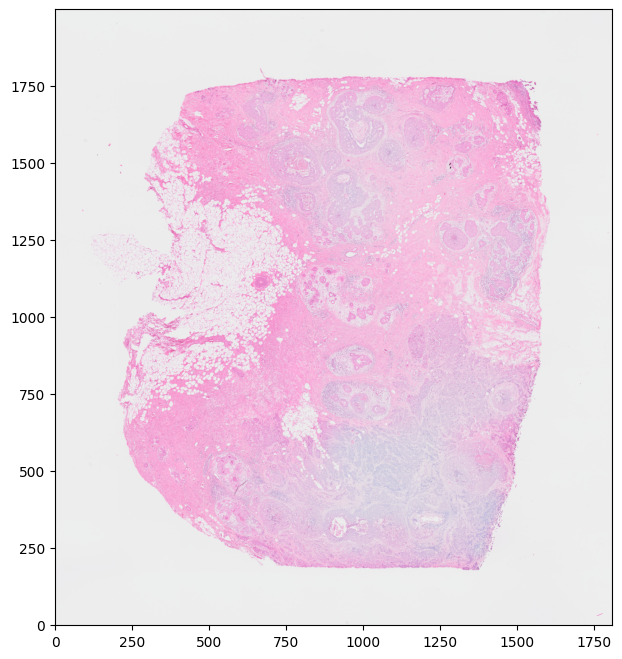

In [4]:
fig = plt.figure(figsize = (8, 8))
ax = plt.gca()
ax.imshow(skimread(path_to_visium_bundle / "spatial" / "tissue_hires_image.png"), origin="lower")

In [5]:
demon_paths = {
    "he_img": path_to_visium_bundle / "spatial" / "tissue_hires_image.png",
    "cell_type": path_to_xenium_celltype_labels,
    "cell_info": path_to_xenium_bundle / "cells.csv.gz",
    "transcript": path_to_xenium_bundle / "transcripts.parquet",
    "cell_count": path_to_xenium_bundle / "cell_feature_matrix.h5",
    'morph_img': path_to_xenium_bundle / "morphology_mip.ome.tif",
}

xenium_to_morphology_transformation = get_xenium_to_morphology_transform_from_xenium_morphology_image(
        path_to_xenium_bundle / "morphology_mip.ome.tif", 0
    )

xenium_morphology_to_visium_full_res_transformation = np.array(
    [
        [1.87594468e-02, -4.07641677e-01, 1.63476055e04],
        [3.91300071e-01, 1.26819551e-02, 4.12499099e03],
        [-8.39854141e-08, -9.91112632e-07, 1.03706895e00],
    ]
)

visium_full_to_high_scale = np.array(
    [
        [visium_scale_factors["tissue_hires_scalef"], 0, 0],
        [0, visium_scale_factors["tissue_hires_scalef"], 0],
        [0, 0, 1],
    ], dtype = float
)

demon_affline = visium_full_to_high_scale @ (xenium_morphology_to_visium_full_res_transformation @ xenium_to_morphology_transformation)

[WARNING] xenium: H&E image doesn't have um to pixel conversion.
[INFO] xenium: Total transcript count: 42638083...
[INFO] xenium: After filtering for QC and unassigned cell id, total transcript counts : 32143179...
[INFO] xenium: After filtering for only selected genes, total transcript counts : 31450291...
[INFO] xenium: Locations converted.  Now plotting...


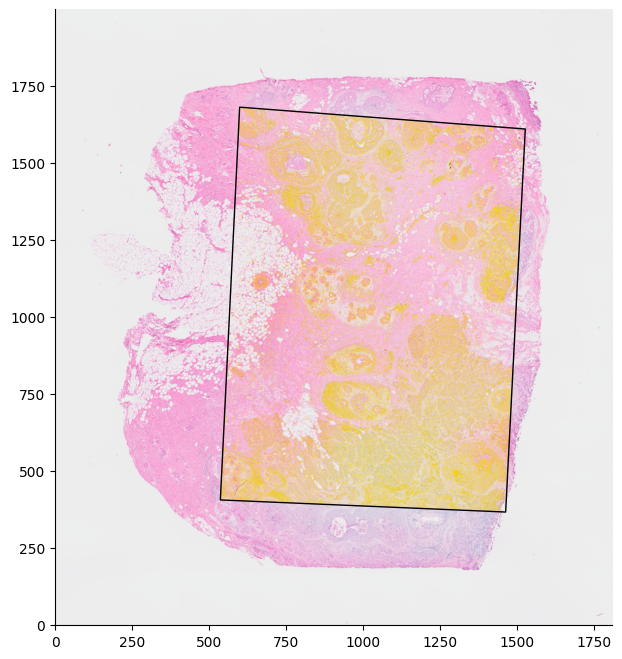

In [6]:
demon_xenium = xenium_module.Xenium(paths = demon_paths, afline_mat = demon_affline, selected_genes = visium_adata.var.index.tolist())

Now let's do the same with Xenium replication 2: 

In [47]:
rep2_path = {
    "he_img": path_to_visium_bundle / "spatial" / "tissue_hires_image.png",
    "cell_type": path_to_xenium_celltype_labels,  # let's not care about the cell type for now.  All use rep 1 cell type proportion 
    "cell_info": path_to_xenium_rep2_bundle / "cells.csv.gz",
    "transcript": path_to_xenium_rep2_bundle / "transcripts.parquet",
    "cell_count": path_to_xenium_rep2_bundle / "cell_feature_matrix.h5",
    'morph_img': path_to_xenium_rep2_bundle / "morphology_mip.ome.tif",
}

xenium_rep2_to_morphology = get_xenium_to_morphology_transform_from_xenium_morphology_image(
        path_to_xenium_bundle / "morphology_mip.ome.tif", 0
    )

rep2_morphology_to_rep1_morphology = np.array(
    [
        [1.0048218381499400,	-0.036326146343110600,	-1330.4508310249200],
        [0.036326146343110600,	1.0048218381499400,	8230.273004290340],
        [0,	0,	1],
    ]
)

xenium_morphology_to_visium_full_res_transformation = np.array(
    [
        [1.87594468e-02, -4.07641677e-01, 1.63476055e04],
        [3.91300071e-01, 1.26819551e-02, 4.12499099e03],
        [-8.39854141e-08, -9.91112632e-07, 1.03706895e00],
    ]
)

visium_full_to_high_scale = np.array(
    [
        [visium_scale_factors["tissue_hires_scalef"], 0, 0],
        [0, visium_scale_factors["tissue_hires_scalef"], 0],
        [0, 0, 1],
    ], dtype = float
)

rep2_affline =visium_full_to_high_scale @ xenium_morphology_to_visium_full_res_transformation @ (rep2_morphology_to_rep1_morphology @ xenium_rep2_to_morphology)

[WARNING] xenium: H&E image doesn't have um to pixel conversion.
[INFO] xenium: Total transcript count: 31997227...
[INFO] xenium: After filtering for QC and unassigned cell id, total transcript counts : 23187422...
[INFO] xenium: After filtering for only selected genes, total transcript counts : 22712763...
[INFO] xenium: Locations converted.  Now plotting...


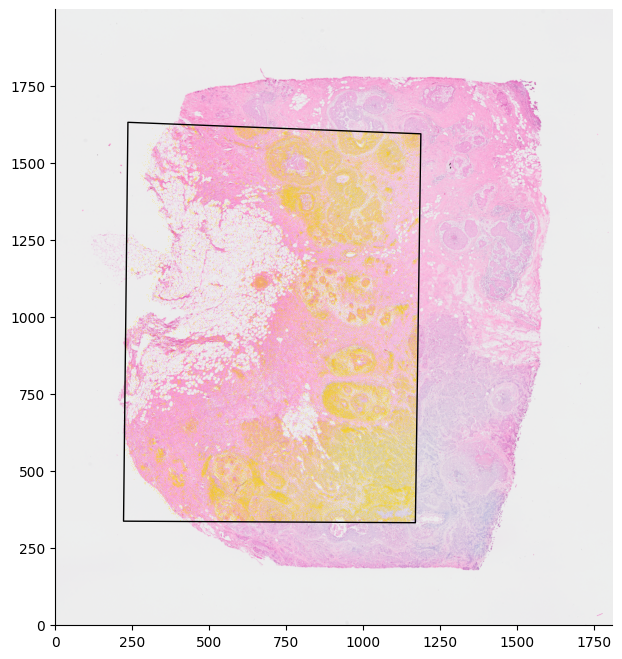

In [48]:
rep2_xenium = xenium_module.Xenium(paths = rep2_path, afline_mat = rep2_affline, selected_genes = visium_adata.var.index.tolist())

### Part 1.3.2: Construct xenium object for breast cancer with post H&E for testing

[INFO] xenium: Successfully extracted H&E meta: 0.36378800370496256 um/pixel
[INFO] xenium: Total transcript count: 42638083...
[INFO] xenium: After filtering for QC and unassigned cell id, total transcript counts : 32143179...
[INFO] xenium: Locations converted.  Now plotting...


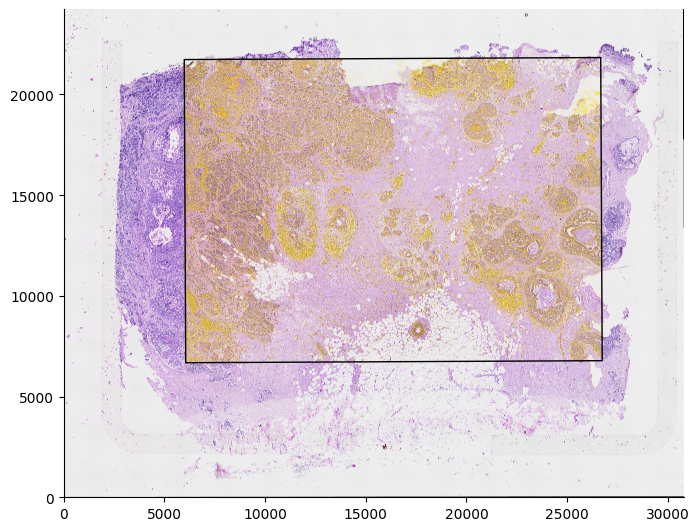

In [5]:
test_paths = {
    "he_img": path_to_xenium_bundle / "Xenium_FFPE_Human_Breast_Cancer_Rep1_he_image.ome.tif",
    "cell_type": path_to_xenium_celltype_labels,
    "cell_info": path_to_xenium_bundle / "cells.csv.gz",
    "transcript": path_to_xenium_bundle / "transcripts.parquet",
    "cell_count": path_to_xenium_bundle / "cell_feature_matrix.h5",
    'morph_img': path_to_xenium_bundle / "morphology_mip.ome.tif",
}

xenium_morphology_to_post_he_transformation = np.linalg.inv(
    np.loadtxt(path_to_xenium_bundle / "Xenium_FFPE_Human_Breast_Cancer_Rep1_he_imagealignment.csv", delimiter=",")
)

xenium_to_morphology_transformation = get_xenium_to_morphology_transform_from_xenium_morphology_image(
        path_to_xenium_bundle / "morphology_mip.ome.tif", 0
    )

test_affline = xenium_morphology_to_post_he_transformation @ xenium_to_morphology_transformation

test_xenium = xenium_module.Xenium(test_paths, test_affline)

In [12]:
cell_type = pd.read_csv(test_xenium.cell_type_path, usecols=["Barcode", "Cluster"])
cell_type = (cell_type.set_index("Barcode", verify_integrity=True))
cell_type.index = cell_type.index.astype(str)
cell_type.index = cell_type.index.astype(str)

test_xenium.cell_info = test_xenium.cell_info.copy()
test_xenium.cell_info.index = test_xenium.cell_info.index.astype(str)

# join by index instead of mixing index + right_on
cell_meta = (test_xenium.cell_info[["x_transformed", "y_transformed"]]
             .join(cell_type, how="left"))

# if you really want Barcode as an index name:
cell_meta.index.name = "Barcode"

array([[ 5965.324 , 21758.422 ],
       [ 6038.6753,  6705.941 ],
       [26719.047 ,  6806.7173],
       [26645.695 , 21859.197 ]], dtype=float32)

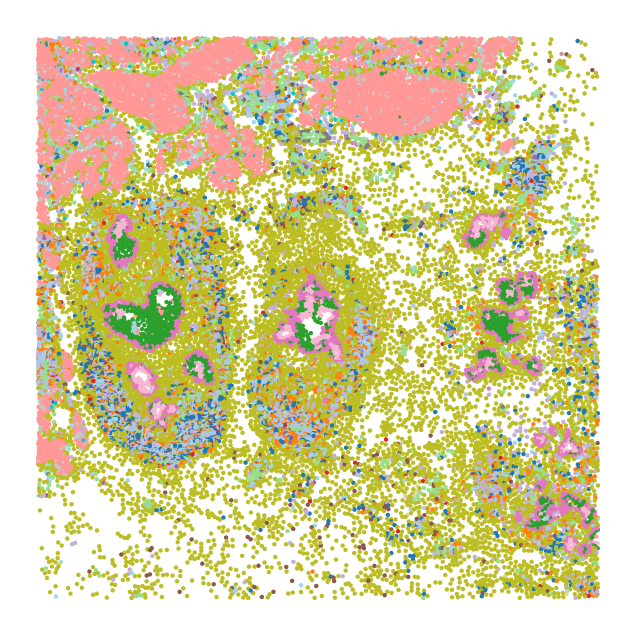

# Part 2: Create Pseudo Spot Polygons
## Part 2.1: Use a set of give coordinates and locations
For demonstration dataset only, we already have a set of real coordinates for visium.  Let's test the method of Xenium that form polygons with give spot coordinates.  We need to make sure the given coordinates are in the coordinate and scale of the default H&E image, which in our case above is the high resolution pre-visium image. For this particular dataset, since we using pre-Visium H&E image as the coordinate and it doesn't have a straightforward conversion to um, we will not implement generation of spots here.

The black polygon is the xenium capture area, whereas the cyan is the capture boundary of given coordinates.

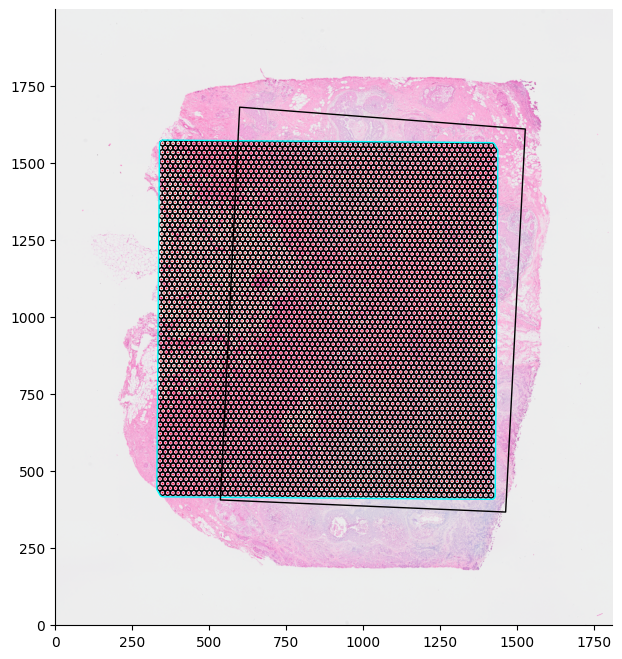

In [49]:
## collect the real visium coordinates and diameter.  Convert into high res resolution
spot_coords = visium_tissue_positions[
        ["pxl_col_in_fullres", "pxl_row_in_fullres"]
    ].values * visium_scale_factors["tissue_hires_scalef"]
diameter = visium_scale_factors["spot_diameter_fullres"]* visium_scale_factors["tissue_hires_scalef"]


demon_xenium.polygons_from_coords(spot_coords, diameter, visium_tissue_positions.index.tolist())

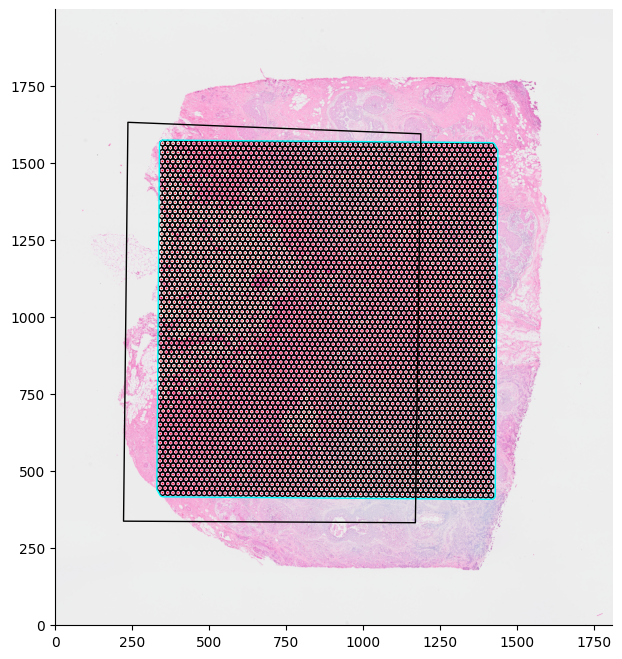

In [50]:
rep2_xenium.polygons_from_coords(spot_coords, diameter, visium_tissue_positions.index.tolist())

## Part 2.2: Generate polygons from an assumed margin, spot diameter, spot-spot distance
We will use the test xenium dataset, which uses post H&E coordinate (like any regular dataset where we don't actually have visium data).   In that case, we assume that the boundary of creating pseudo spot to be margin of xenium capture area minus some margin.  Then we use the assumption that spot is 55 $\mu m$ diameter, and $\mu m$ 100 spaced.

The black polygon is the boundary of the xenium capture area.  The cyan is the boundary of the generated pseudo spots.  The cyan boundary should just be the xenium capture area minus margin on each side.

[INFO] xenium: Generated 3962 spots ....


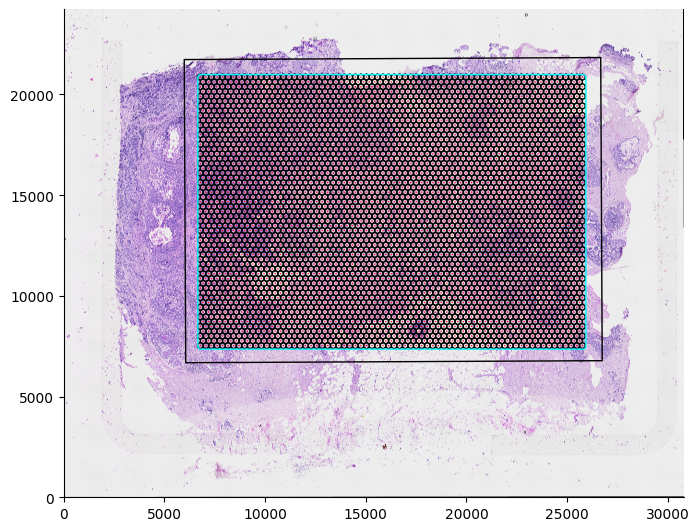

In [7]:
# small
test_xenium.polygons_from_assumption(margin_set = [10000, 17500, 10000, 17500])
# large
# test_xenium.polygons_from_assumption(margin = 300)

In [8]:
test_xenium.generate_pseudo_dongyuan(radius = 27.5)

Processing transcripts: 100%|██████████| 322/322 [00:18<00:00, 17.15batch/s]
[INFO] xenium: Total transcript 32143179, in capture transcript 28416642,in visium disc transcript 7646046


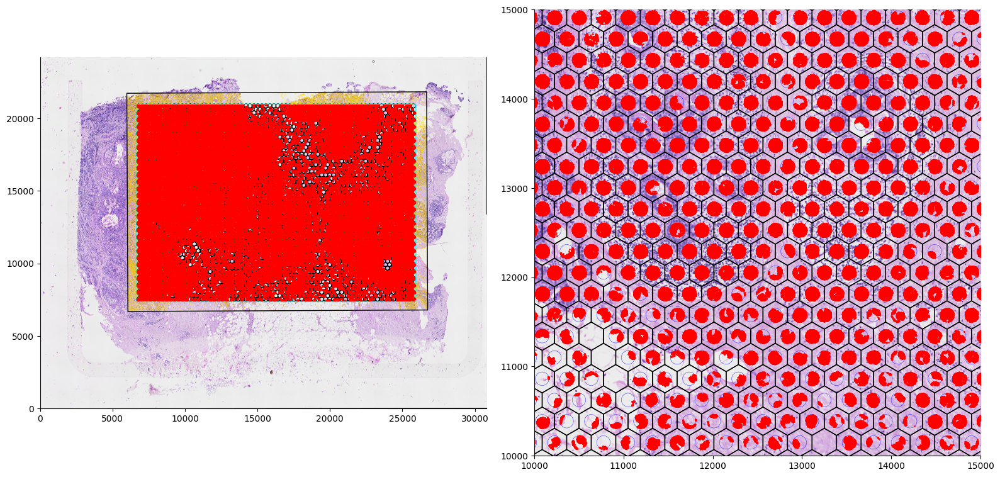

In [9]:
test_xenium.pseudo_visualize(zoom_min = 10000, zoom_max = 15000)

In [10]:
# test_xenium.save_data(path = "breast_cancer_small", cell_type_id_name = "Barcode", cell_type_cluster_name = "Cluster")
test_xenium.save_data(path = "breast_cancer_large", cell_type_id_name = "Barcode", cell_type_cluster_name = "Cluster")

[INFO] xenium: Selected 3903 out of 3903 spots...
[INFO] xenium: selected total 61550 cells...
[INFO] xenium: Finished writing cell spot proportion...
[INFO] xenium: Finished writing cell–gene fraction, strategy 1 drop ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 2 keep ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 3 keep ratio with fallback on n<=3...
[INFO] xenium: Finished saving training cell meta and count information...
[INFO] xenium: Finished saving pseudo meta and count information


# Part 3: Assignment transcripts to pseudo spots
Since we have preliminary results showing Dongyuan's method is better, let's do Dongyuan's method first.

In [51]:
demon_xenium.generate_pseudo_dongyuan(radius = visium_scale_factors["spot_diameter_fullres"]/2 * visium_scale_factors["tissue_hires_scalef"])

Processing transcripts: 100%|██████████| 315/315 [00:16<00:00, 18.73batch/s]
[INFO] xenium: Total transcript 31450291, in capture transcript 27590836,in visium disc transcript 11921120


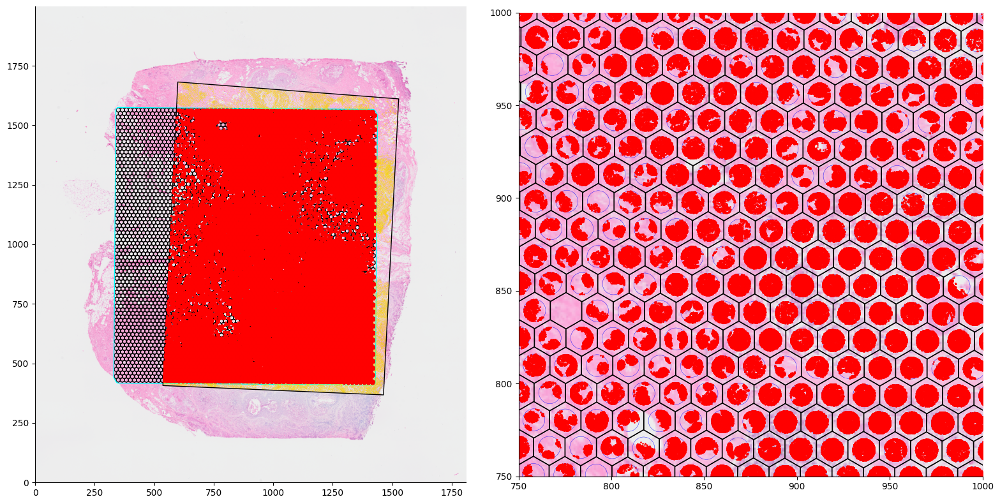

In [52]:
demon_xenium.pseudo_visualize()

In [53]:
rep2_xenium.generate_pseudo_dongyuan(radius = visium_scale_factors["spot_diameter_fullres"]/2 * visium_scale_factors["tissue_hires_scalef"])

Processing transcripts: 100%|██████████| 228/228 [00:12<00:00, 18.82batch/s]
[INFO] xenium: Total transcript 22712763, in capture transcript 19336118,in visium disc transcript 8383617


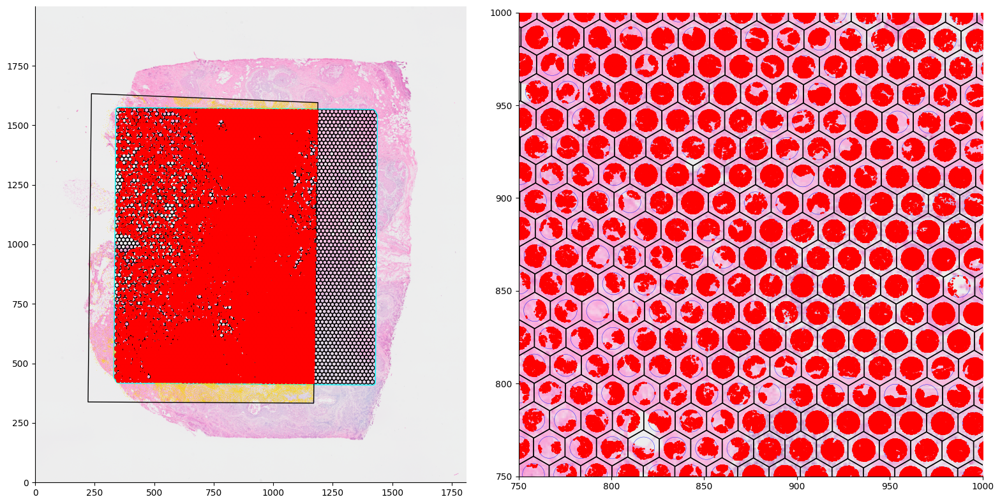

In [54]:
rep2_xenium.pseudo_visualize()

In [37]:
path = Path("breast_cancer_demon")
rep2_xenium.pseudo_count.to_csv(path / "pseudo_count_rep2B.csv")
rep2_xenium.pseudo_meta.to_csv(path / "pseudo_meta_rep2B.csv")

In [55]:
overlap_barcode = demon_xenium.pseudo_count.index.intersection(rep2_xenium.pseudo_count.index)          # or: df1.index.intersection(df2.index, sort=False)
print(f"Rep 1 and rep 2 and visium have {len(overlap_barcode)} common spots...")
demon_xenium.save_data(path = "breast_cancer", sel_spots=np.asarray(overlap_barcode))

[INFO] xenium: Selected 2801 out of 3943 spots...


Rep 1 and rep 2 and visium have 2801 common spots...


[INFO] xenium: selected total 61419 cells...
[INFO] xenium: Finished writing cell spot proportion...
[INFO] xenium: Finished writing cell–gene fraction, strategy 1 drop ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 2 keep ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 3 keep ratio with fallback on n<=3...
[INFO] xenium: Finished saving training cell meta and count information...
[INFO] xenium: Finished saving pseudo meta and count information


# Part 4: Specific to demonstration
## Part 4.1: For 10X genomics strategy

Specifically for demonstration purpose, we also need to extract another version of pseudo spots.  The version of pseudo spots that doesn't really filter out based on visium disc but merely just extract transcripts within overlapping region to each spot.

In [7]:
demon_xenium.generate_pseudo_10x(radius = visium_scale_factors["spot_diameter_fullres"]/2 * visium_scale_factors["tissue_hires_scalef"])

[INFO] root: Total transcript 31450291, in capture transcript 27590836,in visium disc transcript 27590836


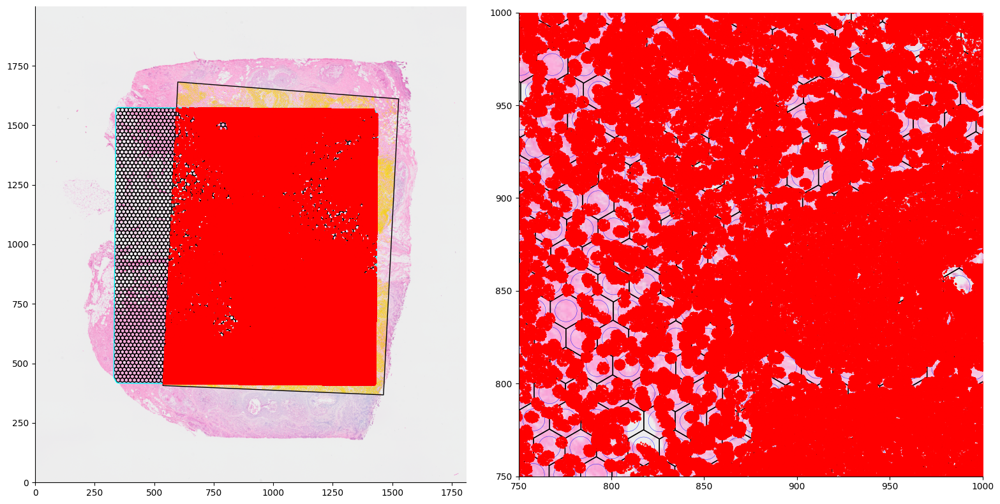

In [8]:
demon_xenium.pseudo_visualize()

In [9]:
## let manually save the pseudo A strategy data
path = Path("breast_cancer_demon")
demon_xenium.pseudo_count.to_csv(path / "pseudo_count_A.csv")
demon_xenium.pseudo_meta.to_csv(path / "pseudo_meta_A.csv")

In [17]:
demon_xenium.pseudo_count.shape

(3986, 307)

## Part 4.2: For Visium data
Now we are at last step of saving visium data.

In [14]:
visium_adata.X.shape

(4992, 18085)

In [20]:
genes_xenium = demon_xenium.pseudo_count.columns.tolist()
genes_xenium = [x.decode('utf-8') if isinstance(x, bytes) else x for x in genes_xenium]
visium_count = pd.DataFrame.sparse.from_spmatrix(visium_adata.X, index = visium_adata.obs.index, columns = visium_adata.var.index)
visium_count[genes_xenium].to_csv(path / "visium_count.csv")
visium_meta = pd.DataFrame(spot_coords, index = visium_adata.obs.index, columns =["x", "y"])
visium_meta.to_csv(path / "visium_meta.csv")

# Part 5: Replication to other datasets 
## Part 5.1: Ovarian Cancer Xenium 5K Dataset 

For this particular dataset, we need to collect its cell type information from analysis.zarr.zip file.  

In [54]:
from pathlib import Path
path_to_ovarian_bundle = Path("../ovarian-xenium")

In [55]:
ovarian_paths = {
    "he_img": path_to_ovarian_bundle / "Xenium_Prime_Ovarian_Cancer_FFPE_XRrun_he_image.ome.tif",
    "cell_type": path_to_ovarian_bundle / "Xenium_Prime_Ovarian_Cancer_FFPE_XRrun_cell_groups.csv",
    "cell_info": path_to_ovarian_bundle / "cells.csv.gz",
    "transcript": path_to_ovarian_bundle / "transcripts.parquet",
    "cell_count": path_to_ovarian_bundle / "cell_feature_matrix.h5",
    'morph_img': path_to_ovarian_bundle / "morphology.ome.tif",
}

xenium_to_morphology_transformation = get_xenium_to_morphology_transform_from_xenium_morphology_image(
        path_to_ovarian_bundle / "morphology.ome.tif", 0
    )
morphology_to_post_he_transformation = np.linalg.inv(
    np.loadtxt(path_to_ovarian_bundle / "Xenium_Prime_Ovarian_Cancer_FFPE_XRrun_he_imagealignment.csv", delimiter=",")
)

ovarian_affline = morphology_to_post_he_transformation @ xenium_to_morphology_transformation

In addition, we need to collect the genes actually on the gene panel and filter out those for negative control. 

In [56]:
import json 
with open(path_to_ovarian_bundle / "gene_panel.json", "r") as f: 
    data = json.load(f)

genes = [
        t["type"]["data"]["name"]
        for t in data["payload"]["targets"]
        if t.get("type", {}).get("descriptor") == "gene"
    ]
genes = set(genes)
print(f"Total json file contain {len(genes)} genes...")

Total json file contain 5101 genes...


[WARNING] xenium: X ratio  0.27381747951119634 and Y ratio 0.2738199162532739 mismatch.
[INFO] xenium: Successfully extracted H&E meta: 0.27381747951119634 um/pixel
[INFO] xenium: Total transcript count: 147706750...
[INFO] xenium: After filtering for QC and unassigned cell id, total transcript counts : 115828096...
[INFO] xenium: After filtering for only selected genes, total transcript counts : 97881401...
[INFO] xenium: Locations converted.  Now plotting...


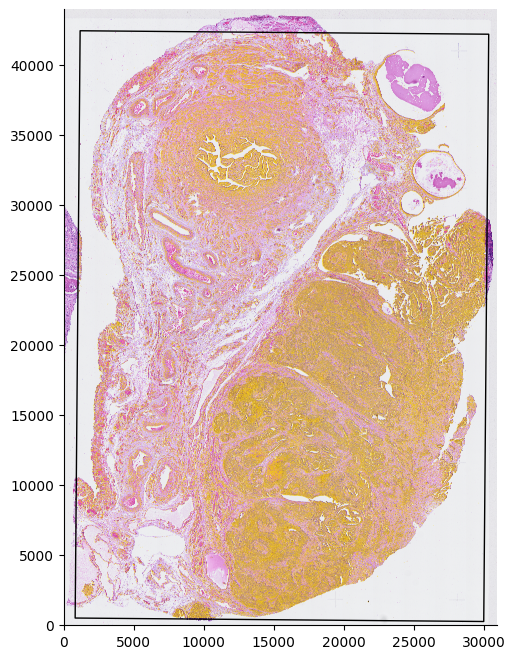

In [83]:
ovarian_xenium = xenium_module.Xenium(paths = ovarian_paths, afline_mat = ovarian_affline, selected_genes = genes)

In [84]:
xmin0 = 10000
xmax0 = 17500
ymin0 = 15000
ymax0 = 25000
cell_type = pd.read_csv(ovarian_xenium.cell_type_path, usecols=["cell_id", "group"])
cell_type = (cell_type.set_index("cell_id", verify_integrity=True))
cell_type.index = cell_type.index.astype(str)

ovarian_xenium.cell_info = ovarian_xenium.cell_info.copy()
ovarian_xenium.cell_info.index = ovarian_xenium.cell_info.index.astype(str)

# join by index instead of mixing index + right_on
cell_meta = (ovarian_xenium.cell_info[["x_transformed", "y_transformed"]]
             .join(cell_type, how="left"))

# if you really want Barcode as an index name:
cell_meta.index.name = "Barcode"
cells_crop = cell_meta[
    (cell_meta["x_transformed"] >= xmin0) &
    (cell_meta["x_transformed"] <= xmax0) &
    (cell_meta["y_transformed"] >= ymin0) &
    (cell_meta["y_transformed"] <= ymax0)
].copy()
cells_crop.to_csv("ovarian_cells.csv", index=False)

In [85]:
print(ovarian_xenium.cell_info.index)

Index(['aaaaebmm-1', 'aaaafhpp-1', 'aaaahcem-1', 'aaaakeoi-1', 'aaaalald-1',
       'aaaalomf-1', 'aaaaojfn-1', 'aaaaokil-1', 'aaabbcfd-1', 'aaabfepp-1',
       ...
       'oiipojad-1', 'oijabnbg-1', 'oijacpeh-1', 'oijalnnk-1', 'oijammpl-1',
       'oijanehc-1', 'oijbbjnb-1', 'oijbcgpd-1', 'oijbdgpi-1', 'oijbekda-1'],
      dtype='object', name='cell_id', length=407124)


In [ ]:
# small 672 spots 
# ovarian_xenium.polygons_from_assumption(margin_set = [10000, 17500, 15000, 25000])
ovarian_xenium.polygons_from_assumption(margin = 1750)

[INFO] xenium: Generated 4278 spots ....


In [74]:
ovarian_xenium.generate_pseudo_dongyuan(radius = 27.5)

Processing transcripts: 100%|██████████| 1065/1065 [00:44<00:00, 23.83batch/s]
[INFO] xenium: Total transcript 106483418, in capture transcript 9833024,in visium disc transcript 2593411


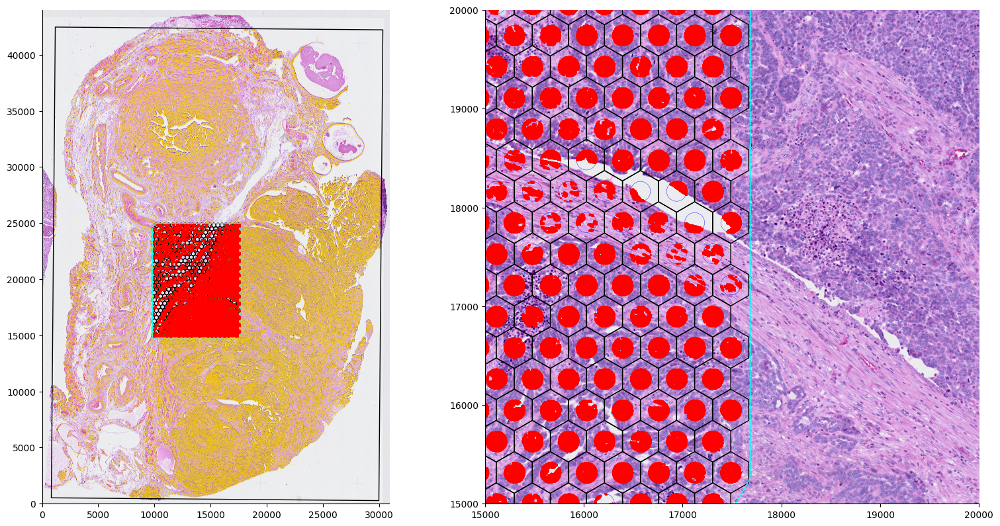

In [75]:
ovarian_xenium.pseudo_visualize(zoom_min = 15000, zoom_max = 20000)

In [76]:
ovarian_xenium.pseudo_count.columns

Index(['A2ML1', 'AAMP', 'AAR2', 'AARSD1', 'ABAT', 'ABCA1', 'ABCA10', 'ABCA3',
       'ABCA4', 'ABCA7',
       ...
       'ZPR1', 'ZSCAN1', 'ZSCAN12', 'ZSCAN16', 'ZSCAN20', 'ZSCAN26', 'ZSWIM6',
       'ZUP1', 'ZYG11B', 'ZYX'],
      dtype='object', length=5101)

In [77]:
# ovarian_xenium.save_data(path = "ovarian_cancer_small", cell_type_id_name = "cell_id", cell_type_cluster_name = "group")
ovarian_xenium.save_data(path = "ovarian_cancer_large", cell_type_id_name = "cell_id", cell_type_cluster_name = "group")

[INFO] xenium: Selected 627 out of 627 spots...
[INFO] xenium: selected total 12284 cells...
[INFO] xenium: Finished writing cell spot proportion...
[INFO] xenium: Finished writing cell–gene fraction, strategy 1 drop ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 2 keep ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 3 keep ratio with fallback on n<=3...
[INFO] xenium: Finished saving training cell meta and count information...
[INFO] xenium: Finished saving pseudo meta and count information


### Alter Saving Code for MEM Efficiency

In [27]:
import logging as log 
import numpy as np, pandas as pd, gc, os, gzip
from scipy import sparse
from scipy.io import mmwrite
logger = log.getLogger(__name__)
pd.options.mode.copy_on_write = True
path = "ovarian_cancer"
path = Path(path)
path.mkdir(parents=True, exist_ok=True)
random_prop = 0 
sel_spots = None

# --- step 1: prune data to ensure efficiency ---
# First prune the data to only the ones we would use: 
if (random_prop is not None) and (random_prop > 0):
    spots_all = np.asarray(ovarian_xenium.pseudo_meta.index, dtype=str)
    k = max(1, len(spots_all) // 2)
    sel_spots = np.sort(np.random.default_rng(42).choice(spots_all, size=k, replace=False))
elif sel_spots is not None: 
    sel_spots = sel_spots 
else:
    sel_spots = np.asarray(ovarian_xenium.pseudo_meta.index, dtype=str)

logger.info(f"Selected {sel_spots.shape[0]} out of {ovarian_xenium.pseudo_meta.shape[0]} spots...")

# keep train / test information
ovarian_xenium.pseudo_meta["group"] = "test"
ovarian_xenium.pseudo_meta.loc[sel_spots, "group"] = "train"

# remoeve all unnecessary columns of transcript 
tr = ovarian_xenium.transcripts.loc[:, ["cell_id", "assigned", "assigned_spot", "feature_name"]].copy()
for c in ["cell_id", "assigned_spot", "feature_name"]:
    tr[c] = tr[c].astype("category")
assigned_mask = tr["assigned"].to_numpy()

# --- step 2: calculate cell spot prop ---
# need a by cell by spot proportion, so we can filter only train cells at this point
# Build sparse counts (assigned only), we used assigned cell spot transcripts / total assigned cell transcripts as proportion 
cell_codes = tr["cell_id"].cat.codes.to_numpy(np.int64)
spot_codes = tr["assigned_spot"].cat.codes.to_numpy(np.int64)
n_cells = tr["cell_id"].cat.categories.size
n_spots = tr["assigned_spot"].cat.categories.size

r = cell_codes[assigned_mask]
c = spot_codes[assigned_mask]
cell_spot = sparse.coo_matrix((np.ones(r.size, np.int32), (r, c)), shape=(n_cells, n_spots)).tocsr()

# Per-cell totals (avoid zero)
cell_total = np.bincount(cell_codes[assigned_mask], minlength=n_cells).astype(np.int32)
cell_total[cell_total == 0] = 1

# Proportions (float32)
inv_tot = 1.0 / cell_total.astype(np.float32)
cell_spot_prop = sparse.diags(inv_tot) @ cell_spot  # CSR float32

# Pick training cells (any mass on selected spots)
spot_idx = pd.Index(tr["assigned_spot"].cat.categories.astype(str))
sel_spot_idx = spot_idx.get_indexer(sel_spots)        # -1 if unseen
sel_spot_idx = sel_spot_idx[sel_spot_idx >= 0]
train_mask = (cell_spot[:, sel_spot_idx].sum(axis=1).A.ravel() > 0)
train_idx = np.flatnonzero(train_mask)

train_cell_ids = tr["cell_id"].cat.categories[train_idx].astype(str)
logger.info(f"selected total {len(train_cell_ids)} cells...")
sel_spot_ids   = spot_cat.categories[sel_spot_idx].astype(str)

# Write Matrix Market + id lists
def write_mtx(base, S, row_ids, col_ids):
    S = S.tocoo().astype(np.float32)
    with gzip.open(f"{base}.mtx.gz", "wb") as f: mmwrite(f, S, field="real")
    pd.Series(row_ids).to_csv(f"{base}.rows.tsv.gz", index=False, header=False, compression="gzip")
    pd.Series(col_ids).to_csv(f"{base}.cols.tsv.gz", index=False, header=False, compression="gzip")

write_mtx(path/"cell_spot_prop",
          cell_spot_prop[train_idx][:, sel_spot_idx],
          train_cell_ids, sel_spot_ids)

logger.info("Finished writing cell spot proportion...")
# del cell_spot, cell_spot_prop; gc.collect()


[INFO] __main__: Selected 2465 out of 2465 spots...
[INFO] __main__: selected total 51971 cells...
[INFO] __main__: Finished writing cell spot proportion...


In [26]:
# --- step 3: calculate cell gene drop out fraction 
gene_codes = tr["feature_name"].cat.codes.to_numpy(np.int64)
n_genes = tr["feature_name"].cat.categories.size

M_total = sparse.coo_matrix((np.ones(cell_codes.size, np.int32), (cell_codes, gene_codes)),
                            shape=(n_cells, n_genes)).tocsr().astype(np.float32)
M_drop  = sparse.coo_matrix((np.ones((~assigned_mask).sum(), np.int32),
                             (cell_codes[~assigned_mask], gene_codes[~assigned_mask])),
                            shape=(n_cells, n_genes)).tocsr().astype(np.float32)

# Safe elementwise division on nonzeros
M_frac = M_drop.multiply(1.0)
M_total_inv = M_total.copy()
M_total_inv.data = 1.0 / M_total_inv.data
M_frac = M_frac.multiply(M_total_inv)

genes = tr["feature_name"].cat.categories.astype(str)

write_mtx(path/"gene_dropout_frac", M_frac[train_idx], train_cell_ids, genes)

logger.info("Finished writing cell gene drop fraction...")

[INFO] __main__: Finished writing cell gene drop fraction...


In [43]:
# --- step 4: export the relevant cell count and meta information 
import pyarrow  # ensure installed
cell_id_col = "cell_id"
type_col = "group"
cell_type = pd.read_csv(ovarian_xenium.cell_type_path, usecols=[cell_id_col,type_col])
cell_meta = (ovarian_xenium.cell_info[["x_transformed","y_transformed"]]
             .merge(cell_type, left_index=True, right_on=cell_id_col, how="left")
             .set_index(cell_id_col))
cell_meta.index = cell_meta.index.astype(str)
cell_meta = cell_meta.loc[train_cell_ids, ["x_transformed","y_transformed",type_col]]
cell_meta.columns = ["x", "y", "type"]
cell_meta.to_parquet(path/"cell_meta.parquet", compression="zstd")
del cell_meta, cell_type; gc.collect()

ad = sc.read_10x_h5(ovarian_xenium.cell_count_path)
X = ad.X.tocsr()
mask = np.isin(ad.obs_names.astype(str), train_cell_ids)

with gzip.open(path/"cell_counts_matrix.mtx.gz", "wb") as f:
    mmwrite(f, X[mask].T.tocoo())  # genes x cells

# barcodes & features (no header)
# barcodes: selected cells (one per line, no header)
pd.Series(ad.obs_names[mask].astype(str)).to_csv(
    path / "cell_count_barcodes.tsv.gz", index=False, header=False, compression="gzip"
)

# features: **only feature names** (one column, no header)
pd.Series(ad.var_names.astype(str)).to_csv(
    path / "cell_count_features.tsv.gz", index=False, header=False, compression="gzip"
)


del ad, X; gc.collect()

logger.info("Finished saving training cell meta and count information...")

[INFO] __main__: Finished saving training cell meta and count information...


In [44]:
# --- step 5: save pseudo_spot information 
ovarian_xenium.pseudo_count.to_parquet(path/"pseudo_count.parquet", compression="zstd")
ovarian_xenium.pseudo_meta.to_parquet(path/"pseudo_meta.parquet", compression="zstd")
logger.info("Finished saving pseudo meta and count information")

[INFO] __main__: Finished saving pseudo meta and count information


## Lymph Node Dataset 

In [64]:
from pathlib import Path
path_to_lymph_bundle = Path("../lymph-xenium")

In [65]:
lymph_paths = {
    "he_img": path_to_lymph_bundle / "Xenium_Prime_Human_Lymph_Node_Reactive_FFPE_he_image.ome.tif",
    "cell_type": path_to_lymph_bundle / "Xenium_Prime_Human_Lymph_Node_Reactive_FFPE_cell_types.csv",
    "cell_info": path_to_lymph_bundle / "cells.csv.gz",
    "transcript": path_to_lymph_bundle / "transcripts.parquet",
    "cell_count": path_to_lymph_bundle / "cell_feature_matrix.h5",
    'morph_img': path_to_lymph_bundle / "morphology.ome.tif",
}

xenium_to_morphology_transformation = get_xenium_to_morphology_transform_from_xenium_morphology_image(
        path_to_lymph_bundle / "morphology.ome.tif", 0
    )
morphology_to_post_he_transformation = np.linalg.inv(
    np.loadtxt(path_to_lymph_bundle / "Xenium_Prime_Human_Lymph_Node_Reactive_FFPE_he_imagealignment.csv", delimiter=",")
)

lymph_affline = morphology_to_post_he_transformation @ xenium_to_morphology_transformation

In [66]:
import json 
with open(path_to_lymph_bundle / "gene_panel.json", "r") as f: 
    data = json.load(f)

genes = [
        t["type"]["data"]["name"]
        for t in data["payload"]["targets"]
        if t.get("type", {}).get("descriptor") == "gene"
    ]
genes = set(genes)
print(f"Total json file contain {len(genes)} genes...")

Total json file contain 4624 genes...


[WARNING] xenium: X ratio  0.2737726437011389 and Y ratio 0.2737751171216795 mismatch.
[INFO] xenium: Successfully extracted H&E meta: 0.2737726437011389 um/pixel
[INFO] xenium: Total transcript count: 232650139...
[INFO] xenium: After filtering for QC and unassigned cell id, total transcript counts : 191101549...
[INFO] xenium: After filtering for only selected genes, total transcript counts : 191004473...
[INFO] xenium: Locations converted.  Now plotting...


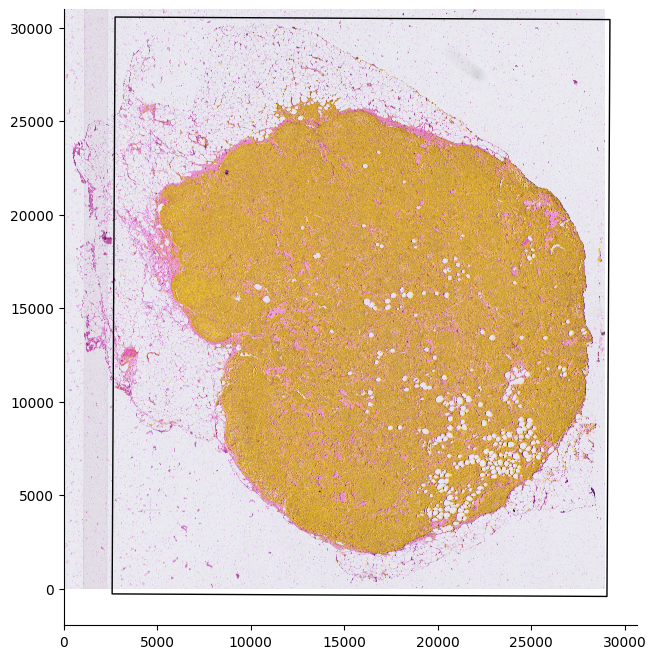

In [67]:
lymph_xenium = xenium_module.Xenium(paths = lymph_paths, afline_mat = lymph_affline, selected_genes = genes)

In [70]:
xmin0 = 12500
xmax0 = 20000
ymin0 = 12500
ymax0 = 20000
cell_type = pd.read_csv(lymph_xenium.cell_type_path, usecols=["cell_id", "group"])
cell_type = (cell_type.set_index("cell_id", verify_integrity=True))
cell_type.index = cell_type.index.astype(str)

lymph_xenium.cell_info = lymph_xenium.cell_info.copy()
lymph_xenium.cell_info.index = lymph_xenium.cell_info.index.astype(str)

# join by index instead of mixing index + right_on
cell_meta = (lymph_xenium.cell_info[["x_transformed", "y_transformed"]]
             .join(cell_type, how="left"))

# if you really want Barcode as an index name:
cell_meta.index.name = "Barcode"
cells_crop = cell_meta[
    (cell_meta["x_transformed"] >= xmin0) &
    (cell_meta["x_transformed"] <= xmax0) &
    (cell_meta["y_transformed"] >= ymin0) &
    (cell_meta["y_transformed"] <= ymax0)
].copy()
cells_crop.to_csv("lymph_cells.csv", index=False)

[INFO] xenium: Generated 504 spots ....


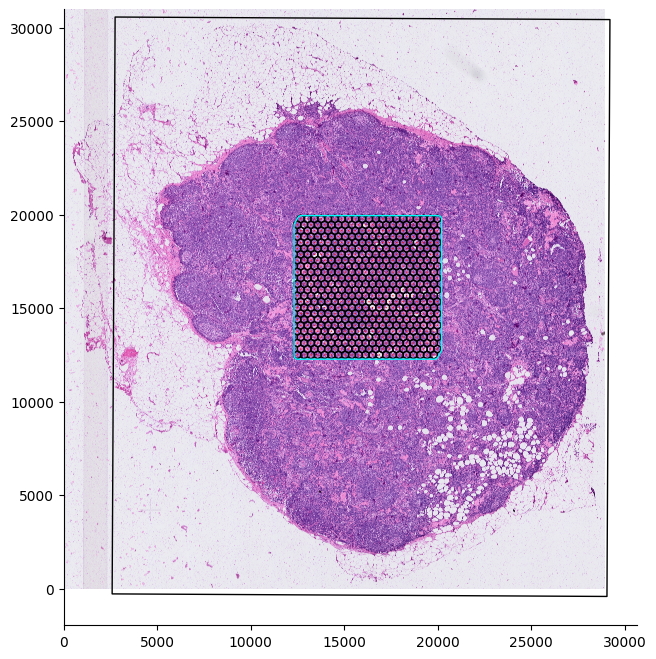

In [82]:
lymph_xenium.polygons_from_assumption(margin_set = [12500, 20000, 12500, 20000])

Processing transcripts: 100%|██████████| 1911/1911 [01:25<00:00, 22.36batch/s]
[INFO] xenium: Total transcript 191004473, in capture transcript 28209078,in visium disc transcript 7467881


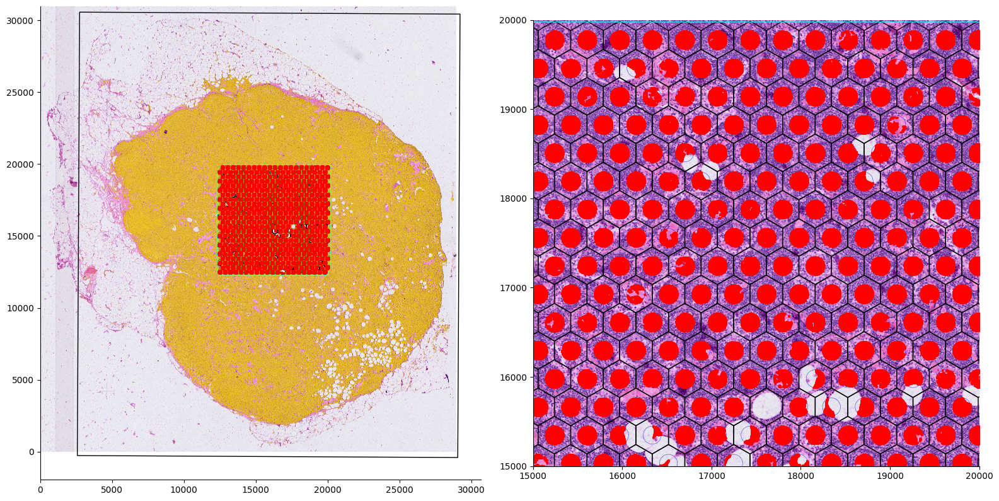

In [83]:
lymph_xenium.generate_pseudo_dongyuan(radius = 27.5)
lymph_xenium.pseudo_visualize(zoom_min = 15000, zoom_max = 20000)

In [84]:
lymph_xenium.save_data(path = "lymph_node_small", cell_type_id_name = "cell_id", cell_type_cluster_name = "group")

[INFO] xenium: Selected 503 out of 503 spots...
[INFO] xenium: selected total 34539 cells...
[INFO] xenium: Finished writing cell spot proportion...
[INFO] xenium: Finished writing cell–gene fraction, strategy 1 drop ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 2 keep ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 3 keep ratio with fallback on n<=3...
[INFO] xenium: Finished saving training cell meta and count information...
[INFO] xenium: Finished saving pseudo meta and count information


## Healthy Human Brain Dataset

In [78]:
from pathlib import Path
path_to_brain_bundle = Path("../brain-xenium")

In [79]:
brain_paths = {
    "he_img": path_to_brain_bundle / "morphology_mip.ome.tif",
    "cell_type": path_to_brain_bundle / "cell_types.csv",
    "cell_info": path_to_brain_bundle / "cells.csv.gz",
    "transcript": path_to_brain_bundle / "transcripts.parquet",
    "cell_count": path_to_brain_bundle / "cell_feature_matrix.h5",
    'morph_img': path_to_brain_bundle / "morphology_mip.ome.tif",
}

xenium_to_morphology_transformation = get_xenium_to_morphology_transform_from_xenium_morphology_image(
        path_to_brain_bundle / "morphology_mip.ome.tif", 0
    )

brain_affline = xenium_to_morphology_transformation

In [86]:
import json 
with open(path_to_brain_bundle / "gene_panel.json", "r") as f: 
    data = json.load(f)

genes = [
        t["type"]["data"]["name"]
        for t in data["payload"]["targets"]
        if t.get("type", {}).get("descriptor") == "gene"
    ]
genes = set(genes)
print(f"Total json file contain {len(genes)} genes...")

Total json file contain 319 genes...


[INFO] xenium: directly using morphology conversion 0.2125 um/pixel ...
[INFO] xenium: Total transcript count: 6849642...
[INFO] xenium: After filtering for QC and unassigned cell id, total transcript counts : 4735271...
[INFO] xenium: After filtering for only selected genes, total transcript counts : 4734427...
[INFO] xenium: Locations converted.  Now plotting...


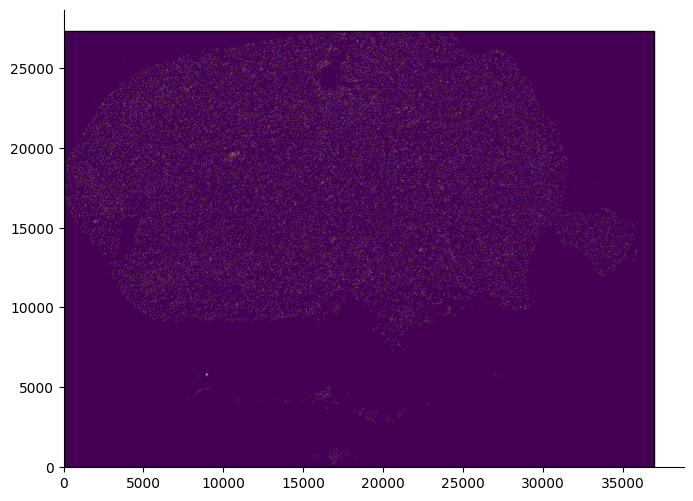

In [81]:
brain_xenium = xenium_module.Xenium(paths = brain_paths, afline_mat = brain_affline, selected_genes = genes, morph_only = True)

[INFO] xenium: Generated 1063 spots ....


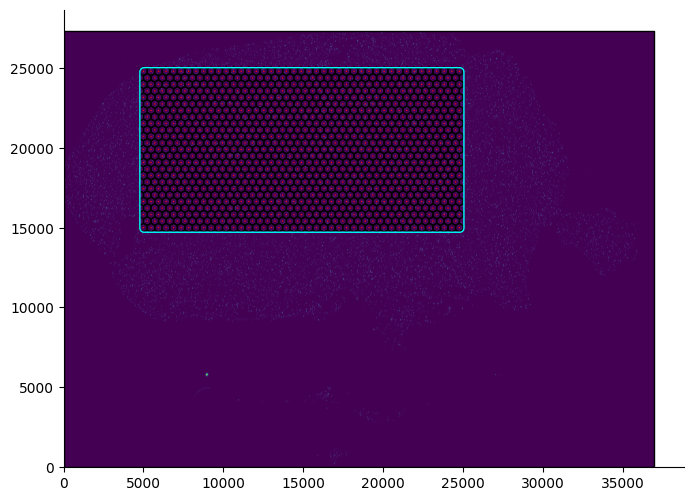

In [82]:
brain_xenium.polygons_from_assumption(margin_set = [5000, 25000, 15000, 25000])

Processing transcripts: 100%|██████████| 48/48 [00:02<00:00, 18.43batch/s]
[INFO] xenium: Total transcript 4734427, in capture transcript 1945389,in visium disc transcript 522562


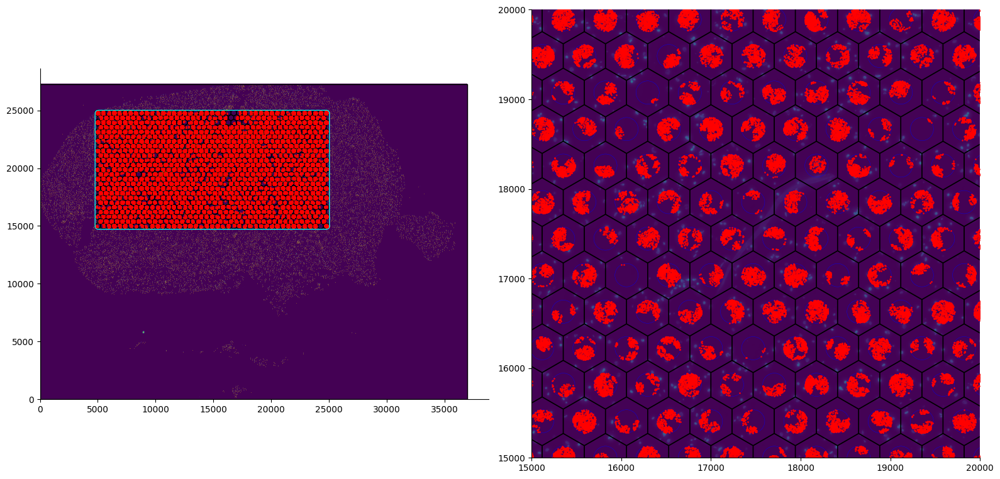

In [83]:
brain_xenium.generate_pseudo_dongyuan(radius = 27.5)
brain_xenium.pseudo_visualize(zoom_min = 15000, zoom_max = 20000)

In [84]:
# to ensure there is no scale problem with the data 
import re, tifffile as tiff
def phys_xy_um(path):
    with tiff.TiffFile(path) as tf:
        xml = tf.ome_metadata or ""
    fx = re.search(r'PhysicalSizeX="([\d.]+)"', xml)
    fy = re.search(r'PhysicalSizeY="([\d.]+)"', xml)
    return (float(fx.group(1)), float(fy.group(1))) if (fx and fy) else (None, None)

print("full:", phys_xy_um(path_to_brain_bundle / "morphology.ome.tif"))
print("mip :", phys_xy_um(path_to_brain_bundle / "morphology_mip.ome.tif"))

full: (0.2125, 0.2125)
mip : (0.2125, 0.2125)


In [85]:
brain_xenium.save_data(path = "brain_healthy", cell_type_id_name = "cell_id", cell_type_cluster_name = "group")

[INFO] xenium: Selected 1058 out of 1058 spots...
[INFO] xenium: selected total 6308 cells...
[INFO] xenium: Finished writing cell spot proportion...
[INFO] xenium: Finished writing cell–gene fraction, strategy 1 drop ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 2 keep ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 3 keep ratio with fallback on n<=3...
[INFO] xenium: Finished saving training cell meta and count information...
[INFO] xenium: Finished saving pseudo meta and count information


In [57]:
cell_type_id_name = "cell_id"
cell_type_cluster_name = "group"
cell_type = pd.read_csv(brain_xenium.cell_type_path, usecols=[cell_type_id_name, cell_type_cluster_name])
cell_type = (cell_type.set_index(cell_type_id_name, verify_integrity=True))
cell_type.index = cell_type.index.astype(str)
cell_meta = (brain_xenium.cell_info[["x_transformed","y_transformed"]]
             .merge(cell_type, left_index=True, right_on=cell_type_id_name, how="left")
             .set_index(cell_type_id_name))

In [62]:
path = Path("brain_healthy")
sel_spots = np.asarray(brain_xenium.pseudo_meta.index, dtype=str)
train_cell_ids = brain_xenium.save_data_transcript_level(path, sel_spots)

[INFO] xenium: selected total 6309 cells...
[INFO] xenium: Finished writing cell spot proportion...
[INFO] xenium: Finished writing cell–gene fraction, strategy 1 drop ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 2 keep ratio...
[INFO] xenium: Finished writing cell–gene fraction, strategy 3 keep ratio with fallback on n<=3...


In [66]:
cell_meta

,x_transformed,y_transformed,group
cell_id,,,
aaaaieod-1,3948.618164,21738.468750,Astrocyte
aaadabdh-1,7804.033203,22042.642578,Cortical_neuron
aaaepfof-1,7868.612305,22266.453125,Astrocyte
aaanldfc-1,4003.184082,22328.486328,Cortical_neuron
aaaonnnp-1,3911.051025,22335.958984,Cortical_neuron
...,...,...,...
ojdmjneo-1,32898.042969,13627.102539,Cortical_neuron
ojdpfnbf-1,32946.414062,13688.107422,Interneuron
ojeagfof-1,32845.386719,13840.898438,Cortical_neuron


In [70]:
cell_meta.index = cell_meta.index.astype(str)
train_cell_ids

Index(['UNASSIGNED', 'aaaepfof-1', 'aabfjnfi-1', 'aacdphll-1', 'aaeancld-1',
       'aaecmcpp-1', 'aaecnlbp-1', 'aafadphf-1', 'aafcabil-1', 'aagailgp-1',
       ...
       'ofehhpbj-1', 'ofekcapp-1', 'ofenbbej-1', 'ofepackm-1', 'offcelfl-1',
       'offjhijd-1', 'offpkcle-1', 'ofhdbdmd-1', 'ofhhbebl-1', 'ofhjdojh-1'],
      dtype='object', length=6309)

In [30]:
cell_meta.index = cell_meta.index.astype(str)
cell_meta = cell_meta.loc[train_cell_ids, ["x_transformed","y_transformed",cell_type_cluster_name]]
cell_meta.columns = ["x", "y", "type"]
cell_meta.to_parquet(path/"cell_meta.parquet", compression="zstd")
del cell_meta, cell_type; gc.collect()

ad = sc.read_10x_h5(brain_xenium.cell_count_path)
X = ad.X.tocsr()
mask = np.isin(ad.obs_names.astype(str), train_cell_ids)

outd = path / "cell_counts_10x"
outd.mkdir(exist_ok=True)

with gzip.open(outd / "matrix.mtx.gz", "wb") as f:
    mmwrite(f, X[mask].T.tocoo())  # genes x cells
pd.Series(ad.obs_names[mask].astype(str)).to_csv(
    outd / "barcodes.tsv.gz", index=False, header=False, compression="gzip"
)

pd.DataFrame({
    0: ad.var_names.astype(str),           # feature_id
    1: ad.var_names.astype(str),           # feature_name
    2: "Gene Expression"                   # feature_type
}).to_csv(outd / "features.tsv.gz", sep="\t", index=False, header=False, compression="gzip")

del ad, X; gc.collect()

logger.info("Finished saving training cell meta and count information...")

In [75]:
brain_xenium.transcripts.loc[0, "cell_id"]

b'UNASSIGNED'

Index(['aaaaieod-1', 'aaadabdh-1', 'aaaepfof-1', 'aaanldfc-1', 'aaaonnnp-1',
       'aabfjnfi-1', 'aabjifjp-1', 'aacdphll-1', 'aacgchbe-1', 'aacifinp-1',
       ...
       'ojcpnjjb-1', 'ojdggfdm-1', 'ojdhgnih-1', 'ojdjemfp-1', 'ojdljmnd-1',
       'ojdmjneo-1', 'ojdpfnbf-1', 'ojeagfof-1', 'ojebfagn-1', 'ojecidjo-1'],
      dtype='object', name='cell_id', length=24406)

Index(['aaaaieod-1', 'aaadabdh-1', 'aaaepfof-1', 'aaanldfc-1', 'aaaonnnp-1',
       'aabfjnfi-1', 'aabjifjp-1', 'aacdphll-1', 'aacgchbe-1', 'aacifinp-1',
       ...
       'ojcpnjjb-1', 'ojdggfdm-1', 'ojdhgnih-1', 'ojdjemfp-1', 'ojdljmnd-1',
       'ojdmjneo-1', 'ojdpfnbf-1', 'ojeagfof-1', 'ojebfagn-1', 'ojecidjo-1'],
      dtype='object', name='cell_id', length=24240)

,x_transformed,y_transformed,group
cell_id,,,
aaaaieod-1,3948.618164,21738.468750,Astrocyte
aaadabdh-1,7804.033203,22042.642578,Cortical_neuron
aaaepfof-1,7868.612305,22266.453125,Astrocyte
aaanldfc-1,4003.184082,22328.486328,Cortical_neuron
aaaonnnp-1,3911.051025,22335.958984,Cortical_neuron
...,...,...,...
ojdmjneo-1,32898.042969,13627.102539,Cortical_neuron
ojdpfnbf-1,32946.414062,13688.107422,Interneuron
ojeagfof-1,32845.386719,13840.898438,Cortical_neuron
